In [1]:
import warnings
warnings.filterwarnings('ignore')

In [2]:
import os
import cv2
import json
import glob
import random
import pydicom
import collections

import numpy as np
import pandas as pd
import seaborn as sns
import os.path as osp
import matplotlib.pyplot as plt
from pydicom.pixel_data_handlers.util import apply_voi_lut

In [3]:
!pwd

/kaggle/working


In [4]:
!ls ../input

efficientnet-pytorch  rsna-miccai-brain-tumor-radiogenomic-classification


In [5]:
DATA_ROOT = osp.join("..", "input", "rsna-miccai-brain-tumor-radiogenomic-classification")
TYPES = ("FLAIR", "T1w", "T1wCE", "T2w")
train_df = pd.read_csv(osp.join(DATA_ROOT, "train_labels.csv"))
train_df

,BraTS21ID,MGMT_value
0,0,1
1,2,1
2,3,0
3,5,1
4,6,1
...,...,...
580,1005,1
581,1007,1
582,1008,1
583,1009,0


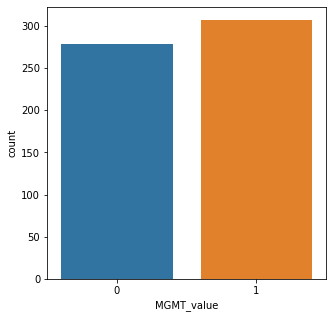

In [6]:
plt.figure(figsize=(5, 5))
sns.countplot(data=train_df, x="MGMT_value");

In [7]:
!ls $DATA_ROOT/train/00000

FLAIR  T1w  T1wCE  T2w


In [8]:
def load_dicom(path):
    dicom = pydicom.read_file(path)
    data = dicom.pixel_array
    data = data - np.min(data)  # (X - X_min) / (X_max - X_min)
    if np.max(data) != 0:
        data = data / np.max(data)
    data = (data * 255).astype(np.uint8)
    return data


def visualize_sample(
    brats21id, 
    mgmt_value,
    slice_i,
    types=("FLAIR", "T1w", "T1wCE", "T2w")
):
    _, axes = plt.subplots(ncols=len(types), figsize=(4*len(types), 5))
    patient_path = os.path.join(DATA_ROOT, "train", str(brats21id).zfill(5))
    for i, t in enumerate(types):
        t_paths = sorted(
            glob.glob(os.path.join(patient_path, t, "*")), 
            key=lambda x: int(x[:-4].split("-")[-1]),
        )
        data = load_dicom(t_paths[int(len(t_paths) * slice_i)])
        axes[i].imshow(data, cmap="gray")
        axes[i].set_title(f"{t}", fontsize=16)
        axes[i].axis("off")

    plt.suptitle(f"MGMT_value: {mgmt_value}", fontsize=16)
    plt.show()

In [9]:
import shutil
shutil.copytree(osp.join(DATA_ROOT, "train", "00000"), "./00000")

'./00000'

In [10]:
!tar -czf example.tar.gz ./00000

In [11]:
!zip -qr 00000.zip ./00000

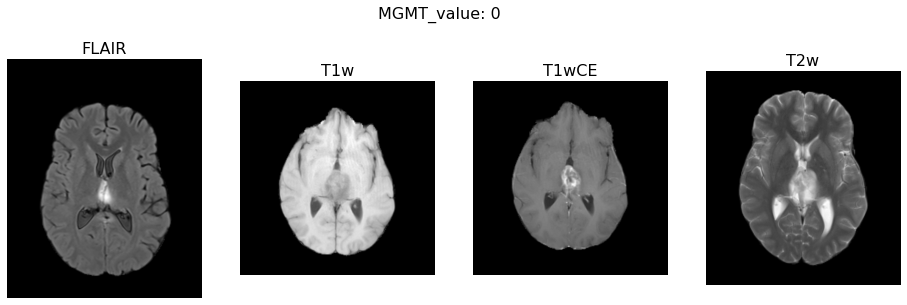

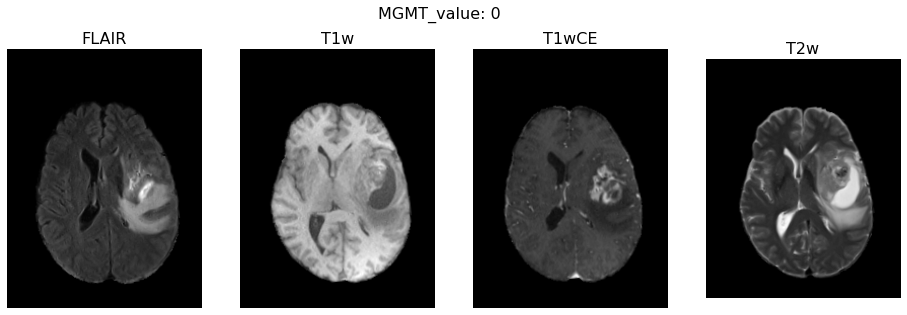

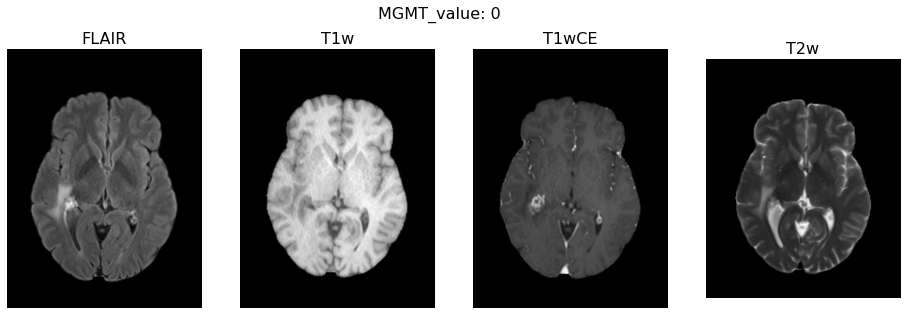

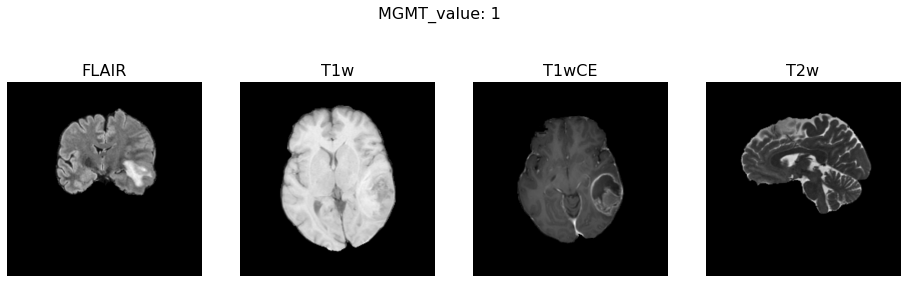

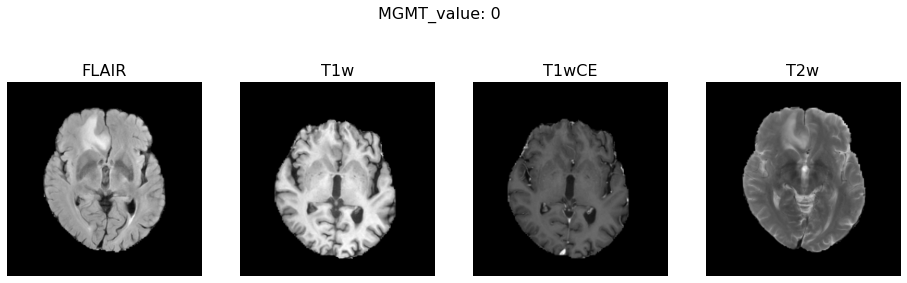

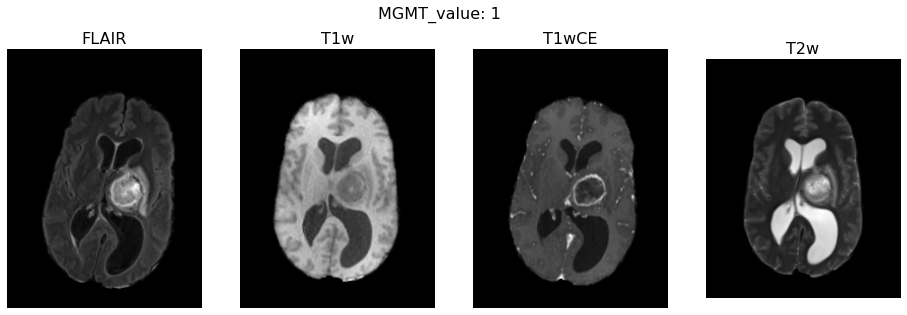

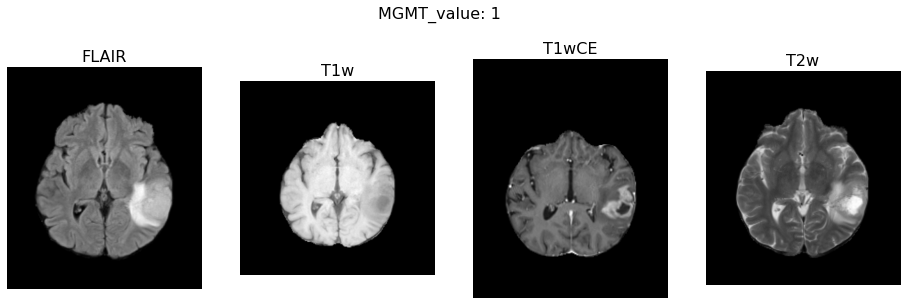

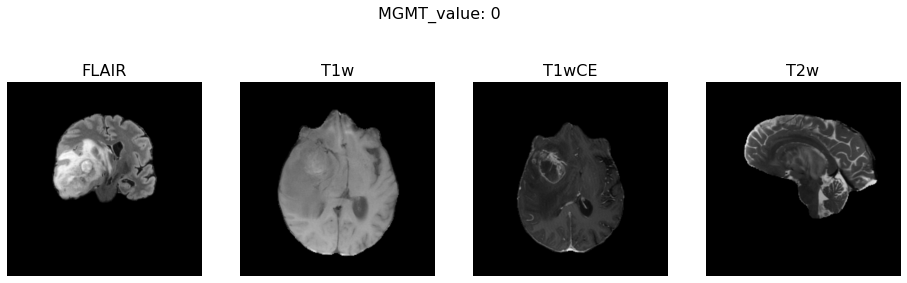

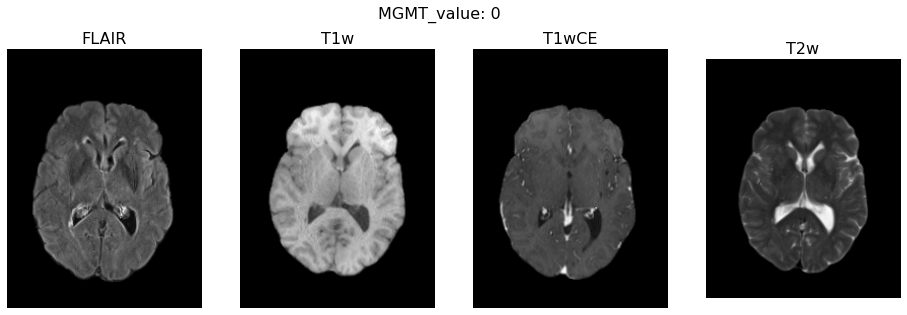

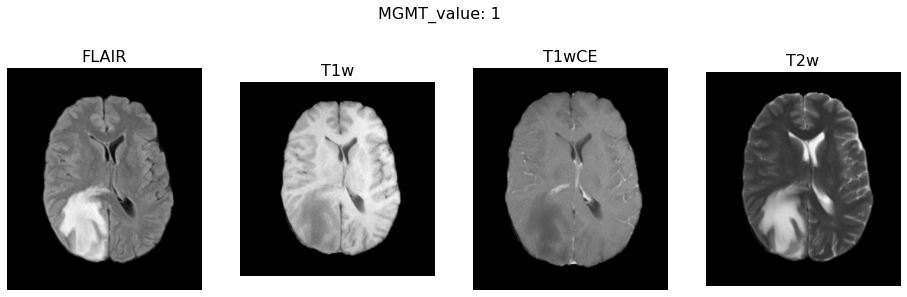

In [12]:
for i in random.sample(range(train_df.shape[0]), 10):
    _brats21id = train_df.iloc[i]["BraTS21ID"]
    _mgmt_value = train_df.iloc[i]["MGMT_value"]
    visualize_sample(brats21id=_brats21id, mgmt_value=_mgmt_value, slice_i=0.5)

In [13]:
from matplotlib import animation, rc
rc('animation', html='jshtml')


def create_animation(ims):
    fig = plt.figure(figsize=(6, 6))
    plt.axis('off')
    im = plt.imshow(ims[0], cmap="gray")
    def animate_func(i):
        im.set_array(ims[i])
        return [im]

    return animation.FuncAnimation(fig, animate_func, frames = len(ims), interval = 1000//24)

In [14]:
def load_dicom_line(path):
    t_paths = sorted(
        glob.glob(os.path.join(path, "*")), 
        key=lambda x: int(x[:-4].split("-")[-1]),
    )
    images = []
    for filename in t_paths:
        data = load_dicom(filename)
        if data.max() == 0:
            continue
        images.append(data)
    return images

In [15]:
%matplotlib notebook

In [16]:
from IPython.display import clear_output
animations = dict()
for t in ("FLAIR", "T1w", "T1wCE", "T2w"):
    images = load_dicom_line(osp.join(DATA_ROOT, 'train', '00000', t))
    animations[t] = create_animation(images)
clear_output()

In [17]:
animations['FLAIR']

In [18]:
animations['T1w']

In [19]:
animations['T1wCE']

In [20]:
animations['T2w']

In [21]:
%matplotlib inline

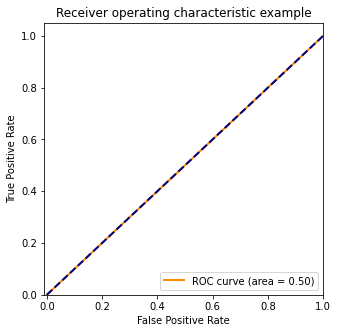

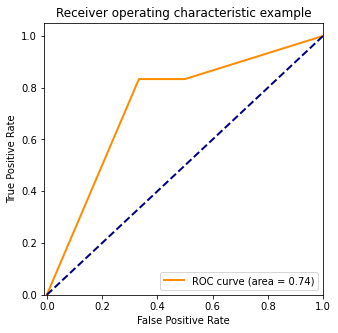

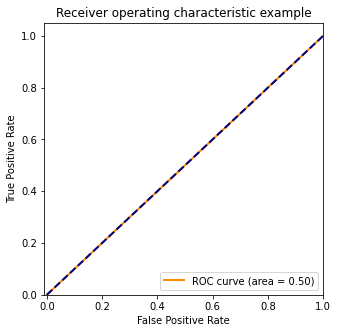

In [22]:
from sklearn.metrics import roc_auc_score, roc_curve, auc

list_y_true = [
    [1., 1., 1., 1., 1., 1., 0., 0., 0., 0., 0., 0.],
    [1., 1., 1., 1., 1., 1., 0., 0., 0., 0., 0., 0.],
    [1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 0.], #  IMBALANCE
]
list_y_pred = [
    [0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5],
    [0.9, 0.9, 0.9, 0.9, 0.1, 0.9, 0.9, 0.1, 0.9, 0.1, 0.1, 0.5],
    [1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.], #  IMBALANCE
]

for y_true, y_pred in zip(list_y_true, list_y_pred):
    fpr, tpr, _ = roc_curve(y_true, y_pred)
    roc_auc = auc(fpr, tpr)

    plt.figure(figsize=(5, 5))
    plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc)
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlim([-0.01, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver operating characteristic example')
    plt.legend(loc="lower right")
    plt.show()

In [23]:
submission = pd.read_csv(osp.join(DATA_ROOT, "sample_submission.csv"))
# submission.to_csv("submission.csv", index=False)
submission

,BraTS21ID,MGMT_value
0,1,0.5
1,13,0.5
2,15,0.5
3,27,0.5
4,37,0.5
...,...,...
82,826,0.5
83,829,0.5
84,833,0.5
85,997,0.5


In [24]:
import time
import torch

from torch import nn
from tqdm.notebook import tqdm
from sklearn.model_selection import StratifiedKFold

from torch.utils import data as torch_data
import torch.nn.functional as torch_functional
import sklearn.model_selection as sk_model_selection

In [25]:
def set_seed(seed):
    random.seed(seed)
    os.environ["PYTHONHASHSEED"] = str(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    if torch.cuda.is_available():
        torch.cuda.manual_seed_all(seed)
        torch.backends.cudnn.deterministic = True
set_seed(42)

In [26]:
class DataRetriever(torch_data.Dataset):
    def __init__(self, img_paths, ids, mri_type="T1wCE", targets=None, folder='train', transforms=None):
        self.ids = ids
        self.img_paths = img_paths
        self.targets = targets
        self.folder = folder
        self.transforms = transforms
        assert mri_type in TYPES
        self.mri_type = mri_type
          
    def __len__(self):
        return len(self.img_paths)
    
    def __getitem__(self, index):
        _id = self.ids[index]
        image_path = self.img_paths[index]
        X = cv2.resize(load_dicom(image_path), (256, 256)) / 255
        X = torch.tensor(X[None,...]).float()
        if self.transforms is not None:
            X = self.transforms(X)
        if self.targets is not None:
            y = torch.tensor(self.targets[index], dtype=torch.float)
            return {"X": X, "y": y, "id": _id}
        return {"X": X, "id": _id}

In [27]:
def get_valid_paths(ids, labels=None, mri_type="T1wCE", folder="train"):
    assert mri_type in TYPES
    all_valid_paths = []
    all_ids = []
    if labels is not None:
        all_labels = []
    for i, patient_id in enumerate(ids):
        patient_path = osp.join(DATA_ROOT, folder, str(patient_id).zfill(5))
        images_paths = sorted(
            glob.glob(osp.join(patient_path, mri_type, "*")),
            key=lambda x: int(x[:-4].split('-')[-1])
        )
        start, end = int(len(images_paths) * 0.25), int(len(images_paths) * 0.75)
        step = 1 if len(images_paths) < 10 else 3
        cur_valid_paths = images_paths[start:end:step]
        all_valid_paths.extend(cur_valid_paths)
        all_ids.extend([patient_id] * len(cur_valid_paths))
        if labels is not None:
            all_labels.extend([labels[i]] * len(cur_valid_paths))
    if labels is not None:
        return all_valid_paths, all_ids, all_labels
    return all_valid_paths, all_ids

ids_train, ids_val, y_train, y_val = \
sk_model_selection.train_test_split(train_df['BraTS21ID'].values,
                                    train_df['MGMT_value'].values,
                                    test_size=0.2,
                                    random_state=42,
                                    stratify=train_df["MGMT_value"],
                                   )
X_train, ids_train, y_train = get_valid_paths(ids_train, labels=y_train)
X_val, ids_val, y_val = get_valid_paths(ids_val, labels=y_val)

In [28]:
np.mean(y_train), np.mean(y_val)

(0.5348855258051999, 0.5529899348727058)

In [29]:
import torchvision.transforms as T
transforms = T.Compose([
    T.CenterCrop((224, 224)),
    T.Lambda(lambda x: x.float()),
])

train_data_retriever = DataRetriever(
    X_train,
    ids_train,
    targets=y_train,
    transforms=transforms,
)

valid_data_retriever = DataRetriever(
    X_val, 
    ids_val,
    targets=y_val,
    transforms=transforms,
)

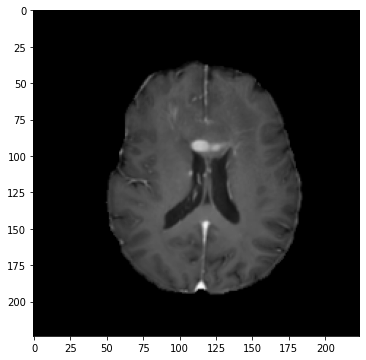

In [30]:
plt.figure(figsize=(6, 6))
plt.imshow(train_data_retriever[120]["X"].numpy()[0], cmap="gray");

In [31]:
from torchvision import models
class Model(nn.Module):
    def __init__(self, model_name="efficientnet-b0", num_classes=2):
        super().__init__()
        assert num_classes >= 2
        num_classes = 1 if num_classes == 2 else num_classes
        self.net = nn.Sequential(
            nn.Conv2d(1, 32, 3, padding=1),  # (N, 32, 224, 224)
            nn.BatchNorm2d(32),
            nn.ReLU(),
            nn.Conv2d(32, 64, 3, padding=1),  # (N, 64, 224, 224)
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.MaxPool2d(2),  # (N, 64, 112, 112)
            nn.Conv2d(64, 128, 3, padding=1),  # (N, 128, 112, 112)
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.Conv2d(128, 128, 3, padding=1),  # (N, 128, 112, 112)
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.MaxPool2d(2),  # (N, 128, 56, 56)
            nn.Conv2d(128, 128, 3, stride=2),  # (N, 128, 27, 27)
            nn.BatchNorm2d(128),
            nn.Dropout2d(p=0.3),
            nn.ReLU(),
            nn.Conv2d(128, 128, 3, stride=2),  # (N, 128, 12, 12)
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.MaxPool2d(2),  # (N, 128, 6, 6)
            nn.Flatten(),
            nn.Linear(128*6*6, 1028),
#             nn.Dropout(p=0.3),
            nn.ReLU(),
            nn.Linear(1028, 512),
            nn.ReLU(),
            nn.Linear(512, num_classes)
        )

    def forward(self, x):
        out = self.net(x)
        return out
model = Model(num_classes=2)
model(torch.randn((4, 1, 224, 224)))

tensor([[ 0.0094],
        [ 0.0899],
        [-0.0224],
        [ 0.0117]], grad_fn=<AddmmBackward>)

In [32]:
class LossMeter:
    def __init__(self):
        self.avg = 0
        self.n = 0

    def update(self, val):
        self.n += 1
        # incremental update
        self.avg = (self.n - 1) / self.n * self.avg + val / self.n

        
class AccMeter:
    def __init__(self):
        self.avg = 0
        self.n = 0
        
    def update(self, y_true, y_pred):
        y_true = y_true.cpu().numpy().astype(int)
        y_pred = y_pred.cpu().numpy() >= 0
        last_n = self.n
        self.n += len(y_true)
        true_count = np.sum(y_true == y_pred)
        # incremental update
        self.avg = last_n / self.n * self.avg + true_count / self.n

In [33]:
class Trainer:
    def __init__(self, model, device, optimizer, criterion, loss_meter, score_meter):
        self.model = model
        self.device = device
        self.optimizer = optimizer
        self.criterion = criterion
        self.loss_meter = loss_meter
        self.score_meter = score_meter
        
        self.best_valid_score = -np.inf
        self.n_patience = 0
        
        self.messages = {
            "epoch": "[Epoch {}: {}] loss: {:.5f}, score: {:.5f}, time: {} s               ",
            "checkpoint": "The score improved from {:.5f} to {:.5f}. Save model to '{}'",
            "patience": "\nValid score didn't improve last {} epochs."
        }
    
    def fit(self, epochs, train_loader, valid_loader, save_path, patience):
        history = {'train': {'loss': [], 'score': []},
                   'val': {'loss': [], 'score': []}}
        for n_epoch in range(1, epochs + 1):
            self.info_message("EPOCH: {}", n_epoch)
            
            train_loss, train_score, train_time = self.train_epoch(train_loader)
            valid_loss, valid_score, valid_time = self.valid_epoch(valid_loader)
            history['train']['loss'].append(train_loss)
            history['train']['score'].append(train_score)
            history['val']['loss'].append(valid_loss)
            history['val']['score'].append(valid_score)
            self.info_message(
                self.messages["epoch"], "Train", n_epoch, train_loss, train_score, train_time
            )
            
            self.info_message(
                self.messages["epoch"], "Valid", n_epoch, valid_loss, valid_score, valid_time
            )

            if self.best_valid_score < valid_score:
                self.info_message(
                    self.messages["checkpoint"], self.best_valid_score, valid_score, save_path
                )
                self.best_valid_score = valid_score
                self.save_model(n_epoch, save_path)
                self.n_patience = 0
            else:
                self.n_patience += 1
            
            if self.n_patience >= patience:
                self.info_message(self.messages["patience"], patience)
                break
        return history
            
    def train_epoch(self, train_loader):
        self.model.train()
        t = time.time()
        train_loss = self.loss_meter()
        train_score = self.score_meter()
        
        for step, batch in enumerate(train_loader, 1):
            X = batch["X"].to(self.device)
            targets = batch["y"].to(self.device)
            self.optimizer.zero_grad()
            outputs = self.model(X).squeeze(1)
            
            loss = self.criterion(outputs, targets)
            loss.backward()

            train_loss.update(loss.detach().item())
            train_score.update(targets, outputs.detach())

            self.optimizer.step()
            
            _loss, _score = train_loss.avg, train_score.avg
            message = 'Train Step {}/{}, train_loss: {:.5f}, train_score: {:.5f}'
            self.info_message(message, step, len(train_loader), _loss, _score, end="\r")
        
        return train_loss.avg, train_score.avg, int(time.time() - t)
    
    def valid_epoch(self, valid_loader):
        self.model.eval()
        t = time.time()
        valid_loss = self.loss_meter()
        valid_score = self.score_meter()

        for step, batch in enumerate(valid_loader, 1):
            with torch.no_grad():
                X = batch["X"].to(self.device)
                targets = batch["y"].to(self.device)
                
                outputs = self.model(X).squeeze(1)
                loss = self.criterion(outputs, targets)

                valid_loss.update(loss.detach().item())
                valid_score.update(targets, outputs)
                
            _loss, _score = valid_loss.avg, valid_score.avg
            message = 'Valid Step {}/{}, valid_loss: {:.5f}, valid_score: {:.5f}'
            self.info_message(message, step, len(valid_loader), _loss, _score, end="\r")
        
        return valid_loss.avg, valid_score.avg, int(time.time() - t)
    
    def save_model(self, n_epoch, save_path):
        torch.save(
            {
                "model_state_dict": self.model.state_dict(),
                "optimizer_state_dict": self.optimizer.state_dict(),
                "best_valid_score": self.best_valid_score,
                "n_epoch": n_epoch,
            },
            save_path,
        )
    
    @staticmethod
    def info_message(message, *args, end="\n"):
        print(message.format(*args), end=end)

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
set_seed(42)

transforms = {
    "train": T.Compose([
        T.CenterCrop((224, 224)),
        T.RandomHorizontalFlip(),
        T.RandomAffine(60),
        T.Lambda(lambda x: x.float()),
    ]),
    "val": T.Compose([
        T.CenterCrop((224, 224)),
        T.Lambda(lambda x: x.float()),
    ])
}

train_data_retriever = DataRetriever(
    X_train,
    ids_train,
    targets=y_train,
    transforms=transforms['train'],
)

valid_data_retriever = DataRetriever(
    X_val, 
    ids_val,
    targets=y_val,
    transforms=transforms['val'],
)

train_loader = torch_data.DataLoader(
    train_data_retriever,
    batch_size=8,
    shuffle=True,
    num_workers=8,
)

valid_loader = torch_data.DataLoader(
    valid_data_retriever,
    batch_size=8,
    shuffle=False,
    num_workers=8,
)

model = Model()
model.to(device)
# optimizer = torch.optim.Adam(model.parameters(), lr=0.001)
optimizer = torch.optim.SGD(model.parameters(), lr=0.0001)
criterion = torch_functional.binary_cross_entropy_with_logits
trainer = Trainer(model, device, optimizer, criterion, LossMeter, AccMeter)
history = trainer.fit(100, train_loader, valid_loader, "best-model-0.pth", 100)

EPOCH: 1
[Epoch Train: 1] loss: 0.69134, score: 0.53000, time: 153 s               
[Epoch Valid: 1] loss: 0.68556, score: 0.55950, time: 12 s               
The score improved from -inf to 0.55950. Save model to 'best-model-0.pth'
EPOCH: 2
[Epoch Train: 2] loss: 0.69011, score: 0.53721, time: 155 s               
[Epoch Valid: 2] loss: 0.68338, score: 0.55802, time: 12 s               
EPOCH: 3
[Epoch Train: 3] loss: 0.69032, score: 0.53209, time: 154 s               
[Epoch Valid: 3] loss: 0.68251, score: 0.56868, time: 12 s               
The score improved from 0.55950 to 0.56868. Save model to 'best-model-0.pth'
EPOCH: 4
[Epoch Train: 4] loss: 0.68978, score: 0.53574, time: 154 s               
[Epoch Valid: 4] loss: 0.68226, score: 0.59355, time: 12 s               
The score improved from 0.56868 to 0.59355. Save model to 'best-model-0.pth'
EPOCH: 5
[Epoch Train: 5] loss: 0.68911, score: 0.53504, time: 154 s               
[Epoch Valid: 5] loss: 0.68005, score: 0.58792, time: 12

In [ ]:
model = Model()
model.to(device)
trained_weights = torch.load(f"best-model-0.pth")
model.load_state_dict(trained_weights["model_state_dict"])
model.eval();

In [ ]:
submission

In [ ]:
submission = pd.read_csv(osp.join(DATA_ROOT, 'sample_submission.csv'))

X_test, ids_test = get_valid_paths(submission['BraTS21ID'], folder='test')

test_data_retriever = DataRetriever(
    X_test, 
    ids_test,
    transforms=transforms['val'],
)

test_loader = torch_data.DataLoader(
    test_data_retriever,
    batch_size=4,
    shuffle=False,
    num_workers=8,
)

In [ ]:
y_pred = []
ids = []

for e, batch in enumerate(test_loader, 1):
    print(f"{e}/{len(test_loader)}", end="\r")
    with torch.no_grad():
        pred = torch.sigmoid(model(batch["X"].to(device))).cpu().numpy().squeeze(1)
        y_pred.extend(pred)
        ids.extend(batch["id"].numpy().tolist())

In [ ]:
submission = pd.DataFrame({"BraTS21ID": ids, "MGMT_value": y_pred})
submission = submission.groupby('BraTS21ID').mean().reset_index()
submission.to_csv("submission.csv", index=False)
submission

In [ ]:
plt.figure(figsize=(5, 5))
plt.hist(submission["MGMT_value"]);

In [ ]:
y_pred = []
ids = []
y_true = []

for e, batch in enumerate(valid_loader, 1):
    print(f"{e}/{len(valid_loader)}", end="\r")
    with torch.no_grad():
        pred = torch.sigmoid(model(batch["X"].to(device))).cpu().numpy().squeeze(1)
        y_pred.extend(pred)
        ids.extend(batch["id"].numpy().tolist())
        y_true.extend(batch["y"].numpy().tolist())

In [ ]:
preds = pd.DataFrame({"BraTS21ID": ids, "MGMT_value": y_pred, "GT": y_true})
preds = preds.groupby('BraTS21ID').mean().reset_index()

In [ ]:
fpr, tpr, _ = roc_curve(preds["GT"], preds["MGMT_value"])
roc_auc = auc(fpr, tpr)

plt.figure(figsize=(5, 5))
plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([-0.01, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic example')
plt.legend(loc="lower right")
plt.show()

In [ ]:
!pip install --upgrade efficientnet-pytorch

In [ ]:
# package_path = "../input/efficientnet-pytorch/EfficientNet-PyTorch/EfficientNet-PyTorch-master/"
# import sys 
# sys.path.append(package_path)

from efficientnet_pytorch import EfficientNet

In [ ]:
ids_train, ids_val, y_train, y_val = \
sk_model_selection.train_test_split(train_df['BraTS21ID'].values,
                                    train_df['MGMT_value'].values,
                                    test_size=0.2,
                                    random_state=42,
                                    stratify=train_df["MGMT_value"],
                                   )

In [ ]:
class DataRetriever(torch_data.Dataset):
    def __init__(self, ids, targets=None, folder='train', transforms=None):
        self.ids = ids
        self.targets = targets
        self.folder = folder
        self.transforms = transforms
          
    def __len__(self):
        return len(self.ids)
    
    def __getitem__(self, index):
        _id = self.ids[index]
        patient_path = osp.join(DATA_ROOT, self.folder, str(_id).zfill(5))
        channels = []
        for t in ("FLAIR", "T1w", "T1wCE"): # "T2w"
            t_paths = sorted(
                glob.glob(os.path.join(patient_path, t, "*")), 
                key=lambda x: int(x[:-4].split("-")[-1]),
            )
            # start, end = int(len(t_paths) * 0.475), int(len(t_paths) * 0.525)
            x = len(t_paths)
            if x < 10:
                r = range(x)
            else:
                d = x // 10
                r = range(d, x - d, d)
                
            channel = []
            # for i in range(start, end + 1):
            for i in r:
                channel.append(cv2.resize(load_dicom(t_paths[i]), (256, 256)) / 255)
            channel = np.mean(channel, axis=0)
            channels.append(channel)
        X = torch.tensor(channels).float()
        if self.transforms is not None:
            X = self.transforms(X)
        if self.targets is not None:
            y = torch.tensor(self.targets[index], dtype=torch.float)
            return {"X": X, "y": y}
        return {"X": X, "id": index}

In [ ]:
train_data_retriever = DataRetriever(
    ids_train, 
    y_train, 
    transforms=transforms['train'],
)

valid_data_retriever = DataRetriever(
    ids_val, 
    y_val,
    transforms=transforms['val'],
)

In [ ]:
train_data_retriever[101]['X'].shape

In [ ]:
plt.figure(figsize=(16, 6))
for i in range(3):
    plt.subplot(1, 3, i + 1)
    plt.imshow(train_data_retriever[100]["X"].numpy()[i], cmap="gray")

In [ ]:
class Model(nn.Module):
    def __init__(self, model_name="efficientnet-b0", num_classes=2):
        super().__init__()
        self.net = EfficientNet.from_pretrained(model_name)
        assert num_classes >= 2
        num_classes = 1 if num_classes==2 else num_classes
        self.net._fc = nn.Sequential(
            nn.Linear(self.net._fc.in_features, 512),
            nn.ReLU(),
            nn.Linear(512, 128),
            nn.ReLU(),
            nn.Linear(128, num_classes)
        )

    def forward(self, x):
        out = self.net(x)
        return out
model = Model(num_classes=2)
model(torch.randn((4, 3, 256, 256)))

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

train_loader = torch_data.DataLoader(
    train_data_retriever,
    batch_size=8,
    shuffle=True,
    num_workers=8,
)

valid_loader = torch_data.DataLoader(
    valid_data_retriever,
    batch_size=8,
    shuffle=False,
    num_workers=8,
)

model = Model()
model.to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)
criterion = torch_functional.binary_cross_entropy_with_logits
trainer = Trainer(model, device, optimizer, criterion, LossMeter, AccMeter)
history = trainer.fit(5, train_loader, valid_loader, "best-model-3channels.pth", 100)

In [ ]:
model = Model()
model.to(device)
trained_weights = torch.load("best-model-3channels.pth")
model.load_state_dict(trained_weights["model_state_dict"])
model.eval();

In [ ]:
submission = pd.read_csv(osp.join(DATA_ROOT, 'sample_submission.csv'))

test_data_retriever = DataRetriever(
    submission["BraTS21ID"].values,
    folder='test',
    transforms=transforms['val'],
)

test_loader = torch_data.DataLoader(
    test_data_retriever,
    batch_size=4,
    shuffle=False,
    num_workers=8,
)

In [ ]:
y_pred = []
ids = []

for e, batch in enumerate(test_loader, 1):
    print(f"{e}/{len(test_loader)}", end="\r")
    with torch.no_grad():
        pred = torch.sigmoid(model(batch["X"].to(device))).cpu().numpy().squeeze(1)
        y_pred.extend(pred)
        ids.extend(batch["id"].numpy().tolist())

In [ ]:
submission = pd.DataFrame({"BraTS21ID": ids, "MGMT_value": y_pred})
submission.to_csv("submission.csv", index=False)
submission

In [ ]:
plt.figure(figsize=(5, 5))
plt.hist(submission["MGMT_value"]);

In [ ]:
!pip install git+https://github.com/shijianjian/EfficientNet-PyTorch-3D

In [ ]:
from efficientnet_pytorch_3d import EfficientNet3D

In [ ]:
counts = {t: [] for t in ("FLAIR", "T1w", "T1wCE", "T2w")}
patient_paths = glob.glob(osp.join(DATA_ROOT, 'train', '*'))
for patient_path in patient_paths:
    for t in ("FLAIR", "T1w", "T1wCE", "T2w"):
        dicom_paths = glob.glob(osp.join(patient_path, t, '*'))
        counts[t].append(len(dicom_paths))

In [ ]:
plt.hist(counts["FLAIR"])

In [ ]:
plt.hist(counts["T1w"])

In [ ]:
plt.hist(counts["T1wCE"])

In [ ]:
plt.hist(counts["T2w"])

In [ ]:
from scipy import stats
for k, val in counts.items():
    print(k, stats.mode(val))

In [ ]:
class DepthCutter():
    def __init__(self, depth, ratio):
        self.depth = depth
        self.ratio = ratio
        assert 0 <= self.ratio <= 1
    
    def construct_3d_image(self, path):
        dicom_paths = sorted(
            glob.glob(os.path.join(path, "*")), 
            key=lambda x: int(x[:-4].split("-")[-1]),
        )
        
        if len(dicom_paths) <= self.depth:
            return self._construct_with_pad(dicom_paths)
        else:
            return self._construct_from_ratio(dicom_paths)
    
    def _construct_with_pad(self, dicom_paths):
        result = np.stack([
            cv2.resize(load_dicom(path), (256, 256))[28:-28,28:-28] / 255
            for path in dicom_paths
        ])
        pad = self.depth - result.shape[0]
        assert pad >= 0
        pad = (pad // 2, pad // 2) if pad % 2 == 0 else (pad // 2, pad // 2 + 1)
        return np.pad(result, pad_width=(pad, (0, 0), (0, 0)))
    
    def _construct_from_ratio(self, dicom_paths):
        start = int(len(dicom_paths) * (1-self.ratio) / 2)
        end = len(dicom_paths) - start
        assert abs(self.ratio - (end - start) / len(dicom_paths)) < 0.1
        dicom_paths = dicom_paths[start:end]
        if len(dicom_paths) <= self.depth:
            return self._construct_with_pad(dicom_paths)
        step = len(dicom_paths) // self.depth
        result = []
        for i in range(0, step*self.depth, step):
            result.append(cv2.resize(load_dicom(dicom_paths[i]), (256, 256))[28:-28,28:-28] / 255)
        result = np.stack(result)
        return result

In [ ]:
class DataRetriever(torch_data.Dataset):
    def __init__(self, ids, targets=None,
                 folder='train', transforms=None,
                 depths_ratios=None
                ):
        self.depths_ratios = {
            "FLAIR": (50, 0.8),
            "T1w": (50, 0.8),
            "T1wCE": (50, 0.8),
            "T2w": (50, 0.8)
        }
        self.ids = ids
        self.targets = targets
        self.folder = folder
        self.transforms = transforms
          
    def __len__(self):
        return len(self.ids)
    
    def __getitem__(self, index):
        _id = self.ids[index]
        patient_path = osp.join(DATA_ROOT, self.folder, str(_id).zfill(5))        
        depths = None
        for t in ("FLAIR", "T1w", "T1wCE", "T2w"):
            dc = DepthCutter(*self.depths_ratios[t])
            depth = dc.construct_3d_image(osp.join(patient_path, t))
            depths = depth if depths is None else np.concatenate([depths, depth])
        X = torch.tensor(depths[None,...]).float()
        if self.transforms is not None:
            X = self.transforms(X)
        if self.targets is not None:
            y = torch.tensor(self.targets[index], dtype=torch.float)
            return {"X": X, "y": y}
        return {"X": X, "id": index}

In [ ]:
train_data_retriever = DataRetriever(
    ids_train, 
    y_train,
)

valid_data_retriever = DataRetriever(
    ids_val, 
    y_val, 
)

In [ ]:
for i in range(10):
    print(train_data_retriever[i]['X'].shape)

In [ ]:
xxx = train_data_retriever[0]['X'].cpu().numpy()

In [ ]:
# plt.imshow(xxx[0][49], cmap='gray')

In [ ]:
class Model(nn.Module):
    def __init__(self, model_name="efficientnet-b0", num_classes=2):
        super().__init__()
        self.net = EfficientNet3D.from_name(model_name, in_channels=1)
        assert num_classes >= 2
        num_classes = 1 if num_classes==2 else num_classes
        self.net._fc = nn.Sequential(
            nn.Linear(self.net._fc.in_features, 512),
            nn.ReLU(),
            nn.Linear(512, 128),
            nn.ReLU(),
            nn.Linear(128, num_classes)
        )

    def forward(self, x):
        out = self.net(x)
        return out
model = Model(num_classes=2)
model(torch.randn((4, 1, 200, 200, 200)))

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

train_loader = torch_data.DataLoader(
    train_data_retriever,
    batch_size=2,
    shuffle=True,
    num_workers=8,
)

valid_loader = torch_data.DataLoader(
    valid_data_retriever,
    batch_size=2,
    shuffle=False,
    num_workers=8,
)

model = Model()
model.to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)
criterion = torch_functional.binary_cross_entropy_with_logits
trainer = Trainer(model, device, optimizer, criterion, LossMeter, AccMeter)
history = trainer.fit(1, train_loader, valid_loader, "best-model-3DCNN.pth",100)

In [ ]:
model = Model()
model.to(device)
trained_weights = torch.load("best-model-3channels.pth")
model.load_state_dict(trained_weights["model_state_dict"])
model.eval();

In [ ]:
submission = pd.read_csv(osp.join(DATA_ROOT, 'sample_submission.csv'))

test_data_retriever = DataRetriever(
    submission["BraTS21ID"].values,
    folder='test'
)

test_loader = torch_data.DataLoader(
    test_data_retriever,
    batch_size=4,
    shuffle=False,
    num_workers=8,
)

In [ ]:
y_pred = []
ids = []

for e, batch in enumerate(test_loader, 1):
    print(f"{e}/{len(test_loader)}", end="\r")
    with torch.no_grad():
        pred = torch.sigmoid(model(batch["X"].to(device))).cpu().numpy().squeeze(1)
        y_pred.extend(pred)
        ids.extend(batch["id"].numpy().tolist())

In [ ]:
submission = pd.DataFrame({"BraTS21ID": ids, "MGMT_value": y_pred})
submission.to_csv("submission.csv", index=False)
submission

In [ ]:
plt.figure(figsize=(5, 5))
plt.hist(submission["MGMT_value"], bins=10, range=(0,1));